### Libraries:

In [ ]:
# !pip install Janitor

In [ ]:
# !pip install pyjanitor

In [1]:
import janitor
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import tqdm
import glob

### Function for missing frame:

In [2]:
def fill_current_missing(data):
    print(data['Frame Number'])
    return data

### Dataset with missing frame by file:

In [5]:
csv_path = r'C:\Users\User\Desktop\rabotno ML\ML- Final Project\Brainster data\1f - Data set'

csv_files = glob.glob(f'{csv_path}/*.csv')

dfs = []
for file in csv_files:
    df = pd.read_csv(file)
    current_missing = df[(df['Frame Number'].diff() > 1) & (df['Stimuli'].diff() == 0)]
    if len(current_missing) > 0:
        print("DATA IS MISSING:", file, len(current_missing))
        new_rows = fill_current_missing(current_missing)
        df = pd.concat([df, new_rows])
    dfs.append(df)

combined = pd.concat(dfs)

DATA IS MISSING: C:\Users\User\Desktop\rabotno ML\ML- Final Project\Brainster data\1f - Data set\10.results-9c4.csv 42
3         9
4        11
13       47
1757      2
1759      6
1764     12
1765     50
2009     92
2011     96
2012     98
2018    108
2019    110
2020    112
2022    116
2027    122
2031    127
2128     15
2135     23
2138     27
2152     42
2153     44
2156     49
2171     66
2193     89
2199     96
2201    100
2315      6
2359     51
2367     60
2620    104
2791     66
2910    186
2918    195
2926    204
2929    208
2984     54
2991     62
2997     70
3048    122
3050    125
3121    199
3122    204
Name: Frame Number, dtype: int64
DATA IS MISSING: C:\Users\User\Desktop\rabotno ML\ML- Final Project\Brainster data\1f - Data set\12.results-032.csv 37
5         6
918      93
1020     51
1025     57
1056     89
1057     93
1140     31
1145     37
1152     45
1206    101
1208    105
1242    140
1248      2
1278     35
1284     42
1292     51
1314     75
1318     80
1336    1

### Dataset with missing frame total:

In [7]:
csv_path = r'C:\Users\User\Desktop\rabotno ML\ML- Final Project\Brainster data\1f - Data set'

csv_files = glob.glob(f'{csv_path}/*.csv')

dfs = []
for file in csv_files:
    df = pd.read_csv(file)
    dfs.append(df)

df_all = pd.concat(dfs)

current_missing = df_all[(df_all['Frame Number'].diff() > 1) & (df_all['Stimuli'].diff() == 0)]
if len(current_missing) > 0:
    print("DATA IS MISSING:", len(current_missing))
    print(current_missing['Frame Number'])

DATA IS MISSING: 317
3         9
4        11
13       47
1757      2
1759      6
       ... 
3015     98
3051    147
3052    149
3053    153
67        7
Name: Frame Number, Length: 317, dtype: int64


### EDA

In [8]:
combined.isnull().sum()

Study_Folder             0
Subject_Folder           0
Stimuli                  0
Frame Number             0
Face_Y                   0
                        ..
Fear_Probability         0
Happiness_Probability    0
Neutral_Probability      0
Sadness_Probability      0
Surprise_Probability     0
Length: 169, dtype: int64

### DATA IS MISSING: 317

In [9]:
combined.duplicated().sum()

317

In [10]:
combined.shape

(106947, 169)

In [11]:
combined.describe()

,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,Left_Eye_X,Left_Eye_Y,...,X_Predictions,Y_Predictions,Anger_Probability,Contempt_Probability,Disgust_Probability,Fear_Probability,Happiness_Probability,Neutral_Probability,Sadness_Probability,Surprise_Probability
count,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,...,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000,106947.000000
mean,3380.952154,79.376504,215.675176,173.806998,226.798255,226.798255,262.258203,369.995138,263.851468,287.103444,...,0.521580,0.543168,0.121416,0.038113,0.082161,0.054799,0.022784,0.004071,0.137849,0.022186
std,4026.924743,52.508695,63.304893,71.446715,34.753668,34.753668,71.625753,53.906371,72.227570,59.146378,...,0.265082,0.271969,0.203558,0.077476,0.146552,0.125291,0.054023,0.014007,0.204968,0.092006
min,0.000000,0.000000,17.000000,16.000000,164.000000,164.000000,90.000000,140.000000,88.000000,76.000000,...,0.122667,0.162500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,35.000000,189.000000,126.000000,202.000000,202.000000,213.000000,351.000000,213.000000,261.000000,...,0.350260,0.196907,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,11.000000,73.000000,222.000000,164.000000,220.000000,220.000000,251.000000,372.000000,255.000000,288.000000,...,0.571178,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,7864.000000,118.000000,253.000000,217.000000,245.000000,245.000000,296.000000,399.000000,301.000000,321.000000,...,0.768325,0.832200,0.170000,0.040000,0.100000,0.020000,0.020000,0.000000,0.260000,0.000000
max,9806.000000,211.000000,447.000000,393.000000,398.000000,398.000000,477.000000,584.000000,481.000000,506.000000,...,0.875000,0.833333,0.950000,0.760000,0.770000,0.880000,0.610000,0.230000,0.910000,1.000000


In [12]:
combined.columns

Index(['Study_Folder', 'Subject_Folder', 'Stimuli', 'Frame Number', 'Face_Y',
       'Face_X', 'Face_W', 'Face_H', 'Right_Eye_X', 'Right_Eye_Y',
       ...
       'X_Predictions', 'Y_Predictions', 'Anger_Probability',
       'Contempt_Probability', 'Disgust_Probability', 'Fear_Probability',
       'Happiness_Probability', 'Neutral_Probability', 'Sadness_Probability',
       'Surprise_Probability'],
      dtype='object', length=169)

In [13]:
combined.dtypes

Study_Folder              object
Subject_Folder            object
Stimuli                    int64
Frame Number               int64
Face_Y                   float64
                          ...   
Fear_Probability         float64
Happiness_Probability    float64
Neutral_Probability      float64
Sadness_Probability      float64
Surprise_Probability     float64
Length: 169, dtype: object

In [14]:
combined.nunique()

Study_Folder              38
Subject_Folder             1
Stimuli                   20
Frame Number             212
Face_Y                   390
                        ... 
Fear_Probability          81
Happiness_Probability     55
Neutral_Probability       23
Sadness_Probability       92
Surprise_Probability     101
Length: 169, dtype: int64

In [15]:
combined.std()

C:\Users\User\AppData\Local\Temp\ipykernel_15440\1676702292.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  combined.std()


Stimuli                  4026.924743
Frame Number               52.508695
Face_Y                     63.304893
Face_X                     71.446715
Face_W                     34.753668
                            ...     
Fear_Probability            0.125291
Happiness_Probability       0.054023
Neutral_Probability         0.014007
Sadness_Probability         0.204968
Surprise_Probability        0.092006
Length: 167, dtype: float64

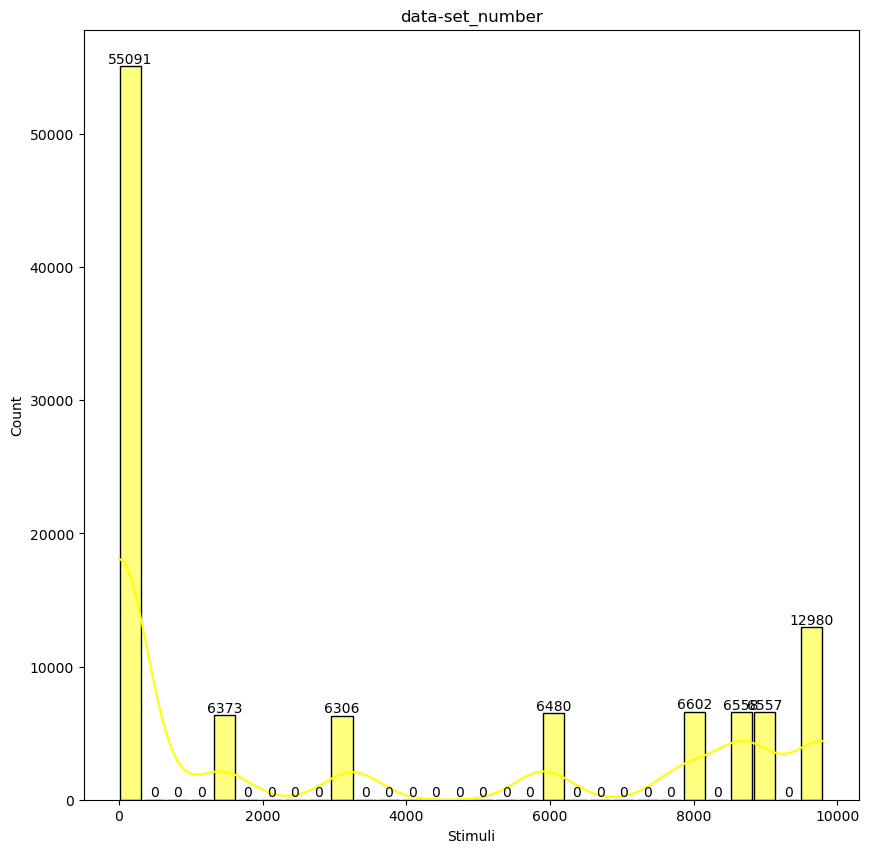

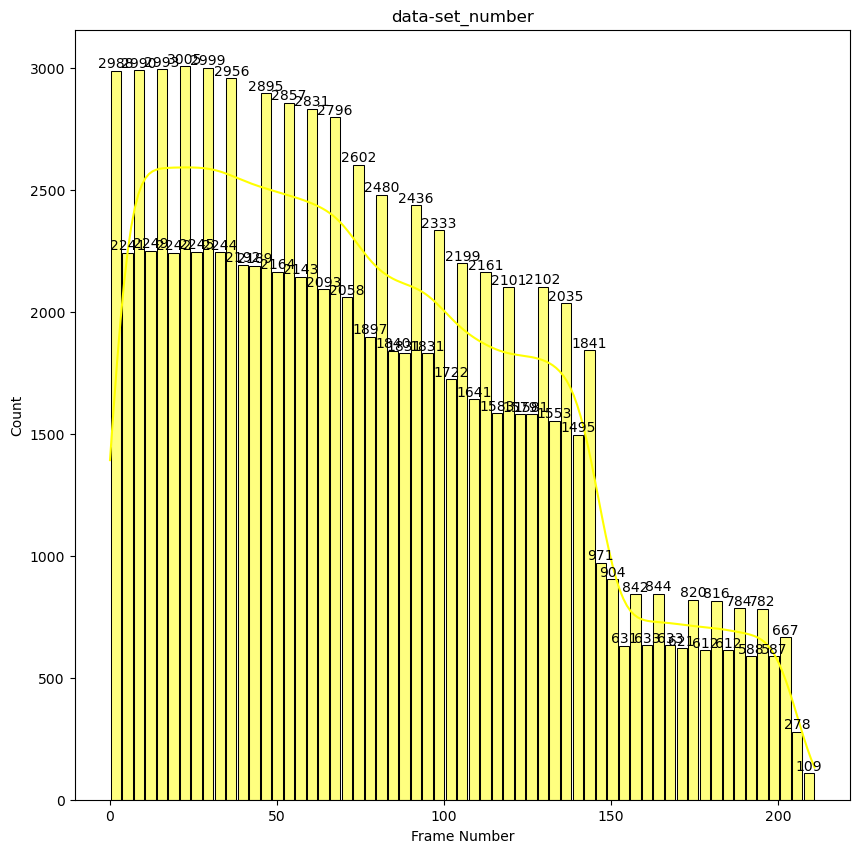

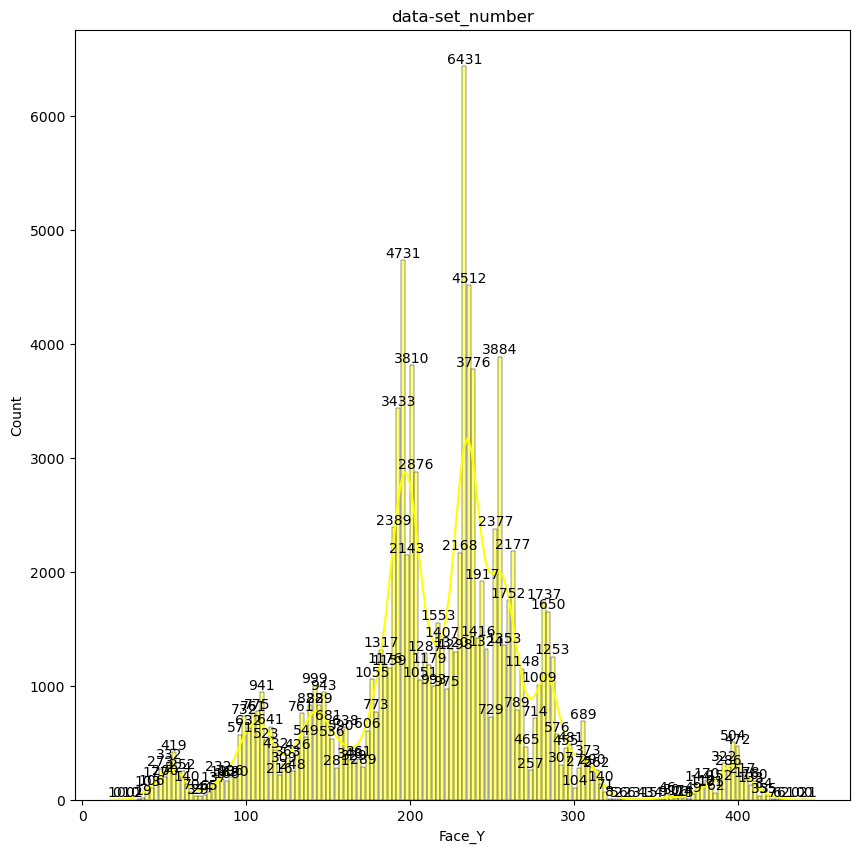

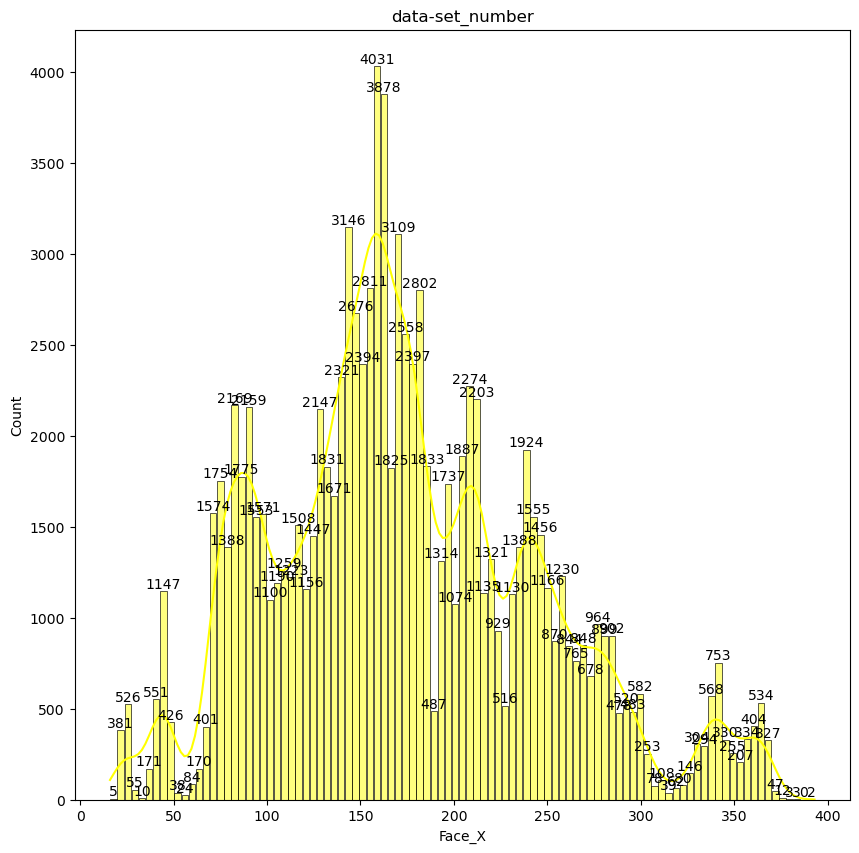

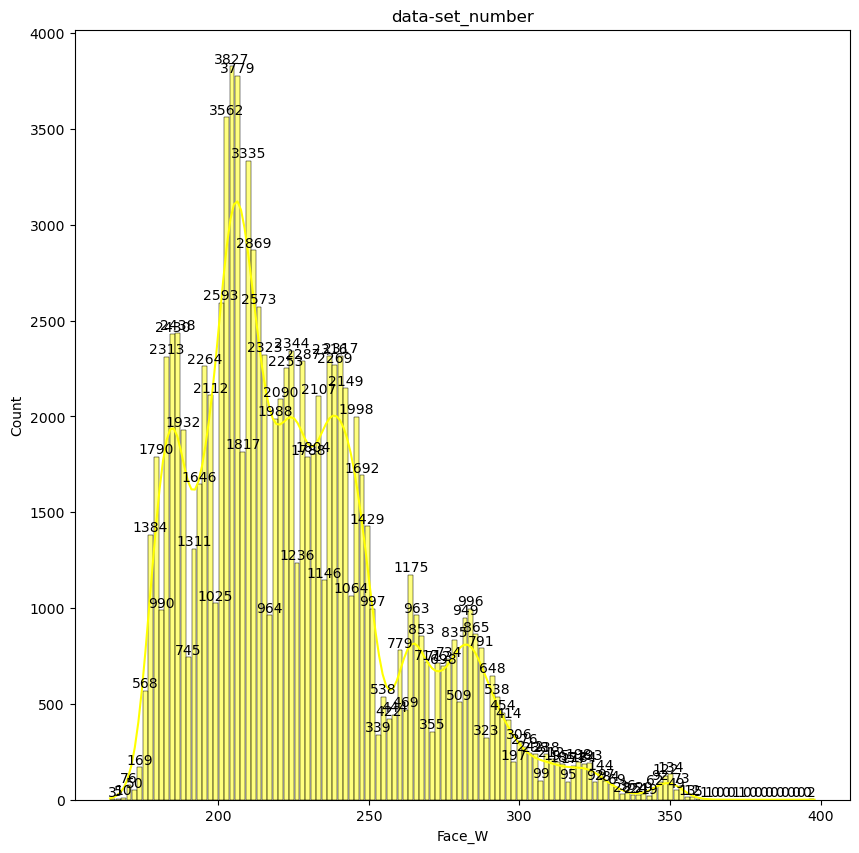

...

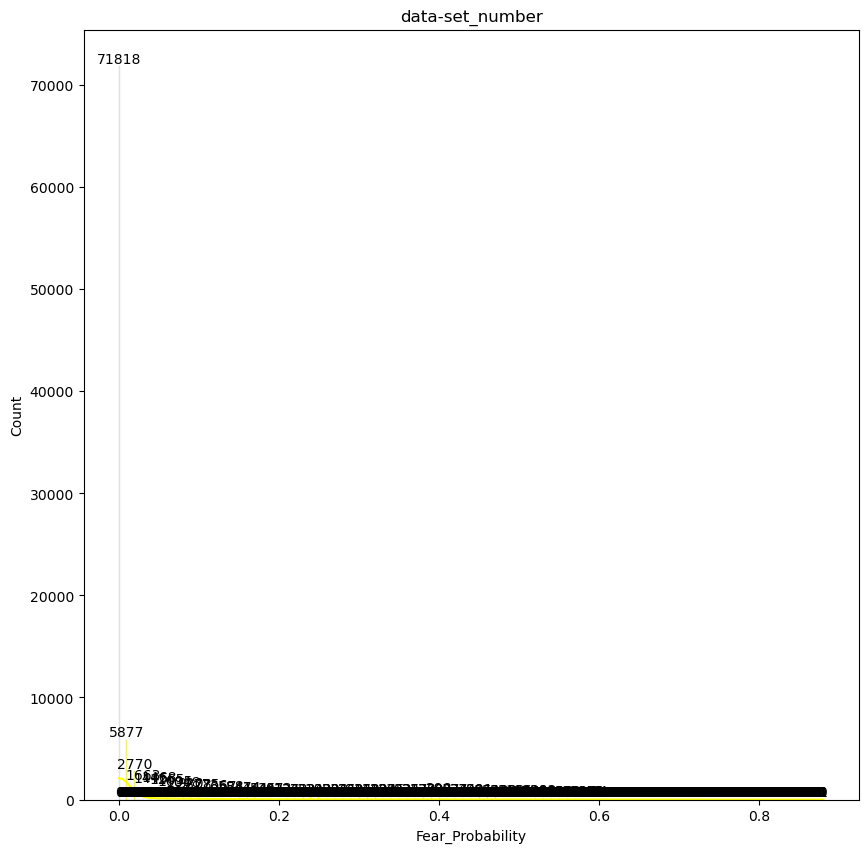

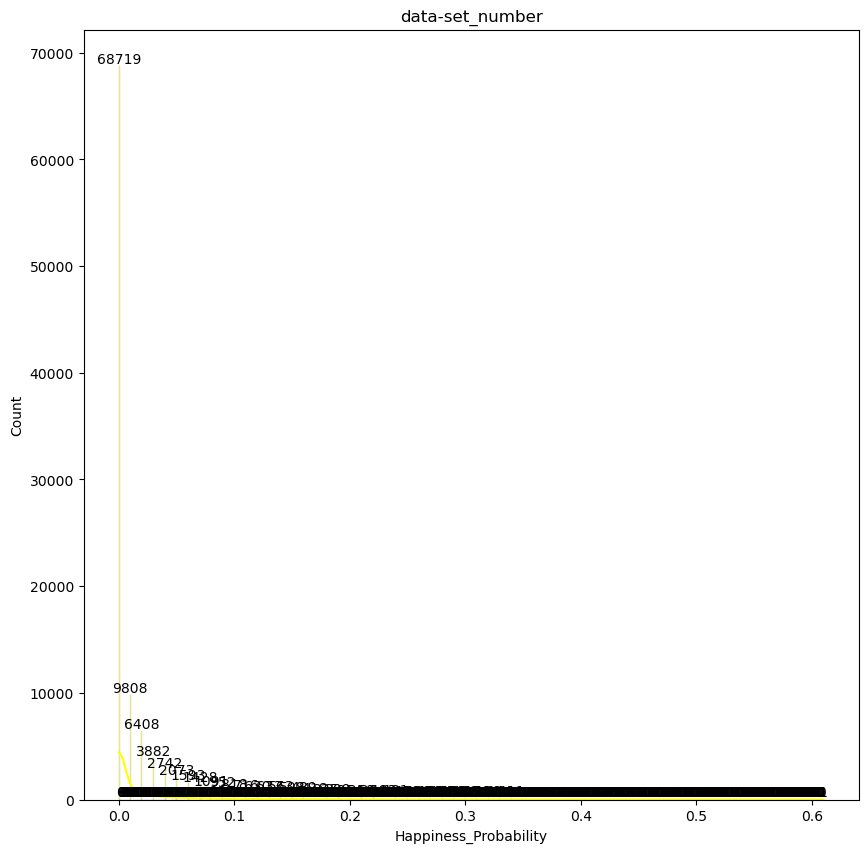

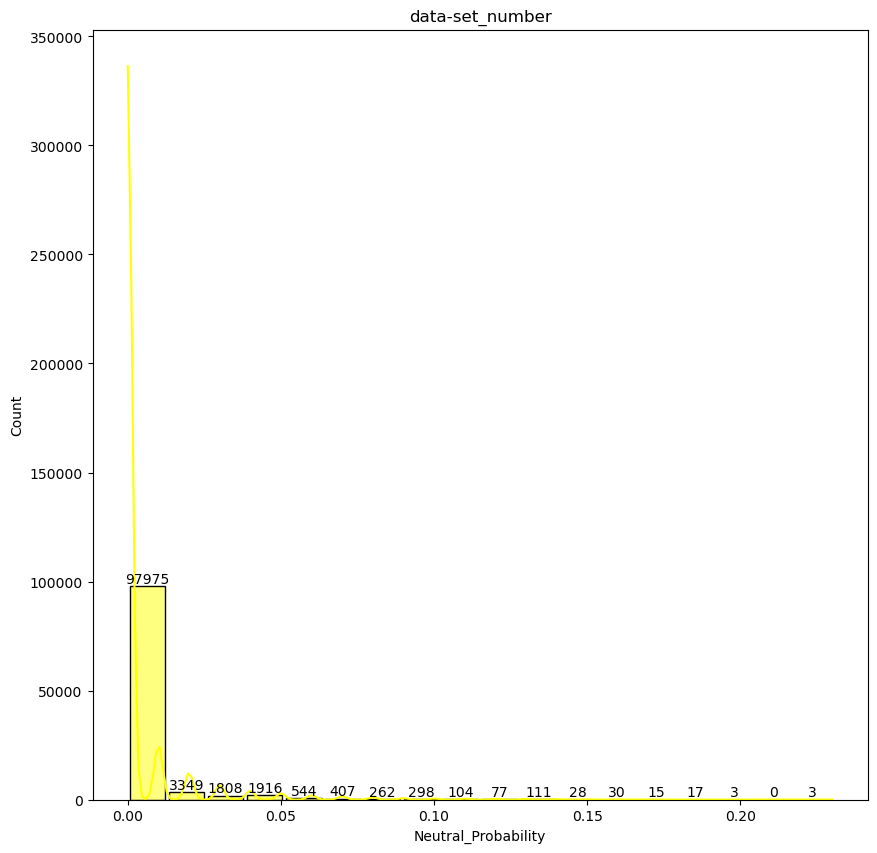

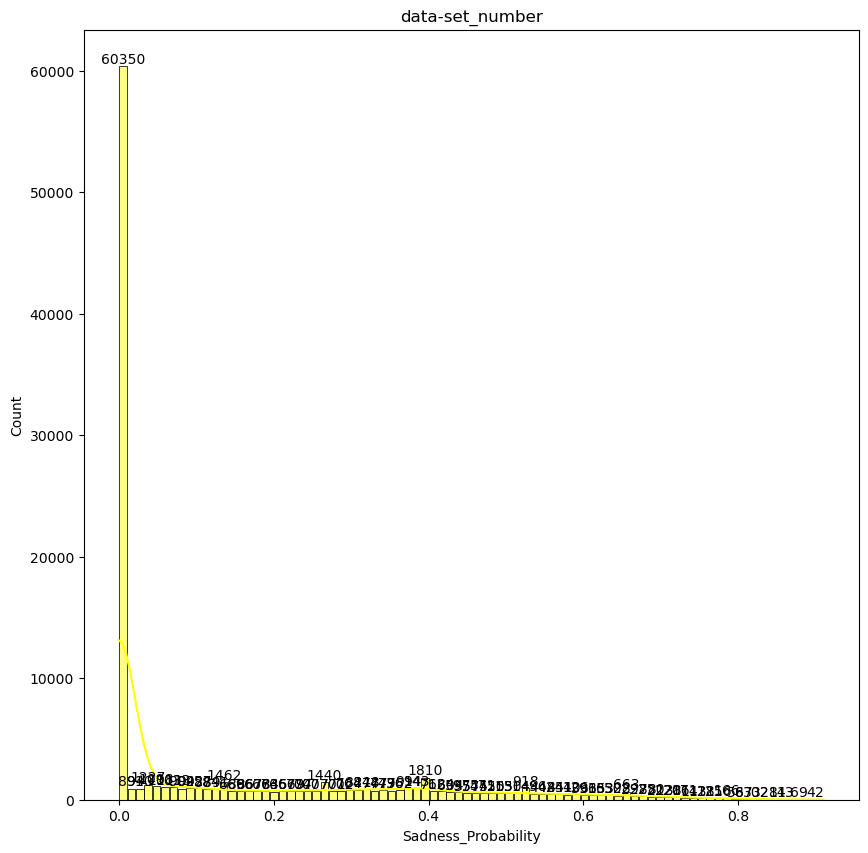

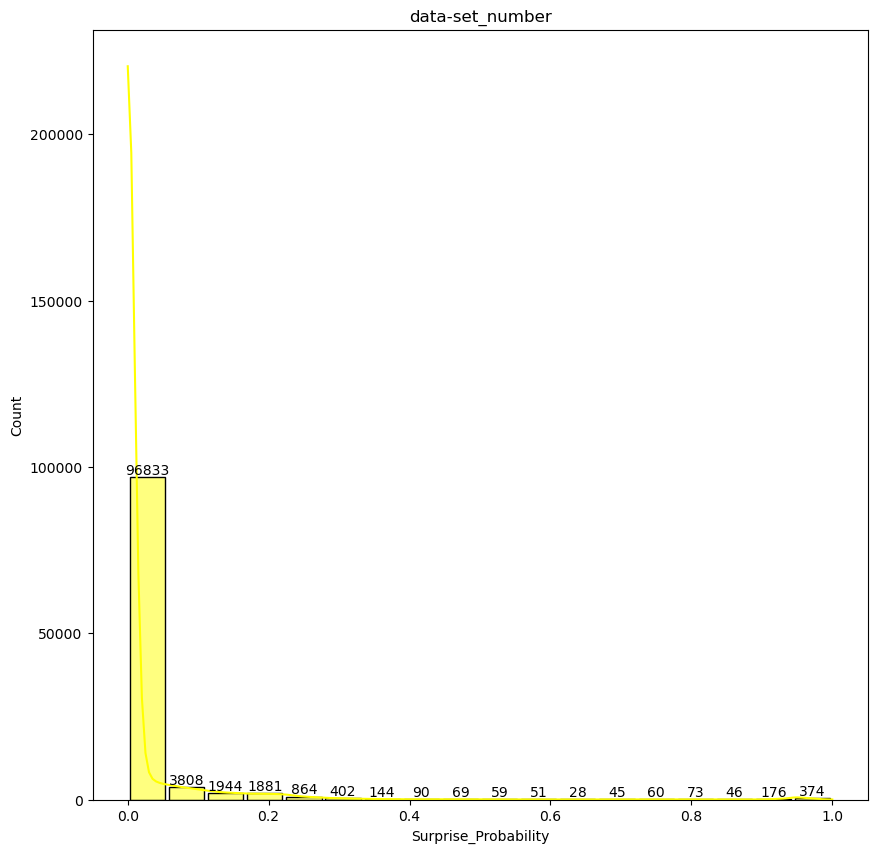

In [16]:
num_cols = combined.select_dtypes(include=np.number).columns.tolist()
for i in num_cols:
    plt.figure(figsize=(10,10))
    y=sns.histplot(x=i, data=combined, shrink=.9,stat='count',kde = True,color='yellow',)
    y.bar_label(y.containers[0])
    plt.title('data-set_number')
    plt.xlabel(i)
    plt.show()

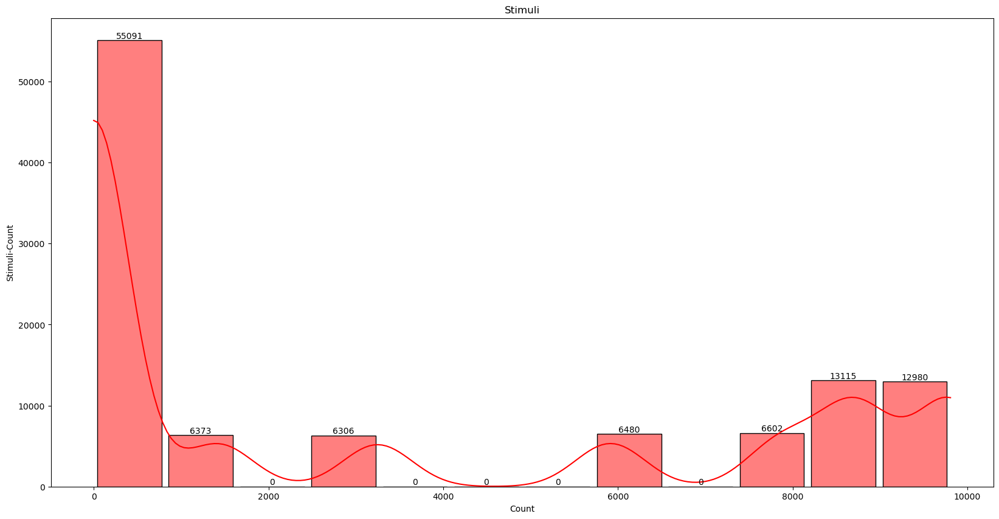

In [17]:
plt.figure(figsize=(20,10))
y=sns.histplot(x='Stimuli', data=combined, bins=12, shrink=.9,stat='count',kde = True,color='red',)
y.bar_label(y.containers[0])
plt.title('Stimuli')
plt.xlabel('Count')
plt.ylabel('Stimuli-Count')
plt.show()

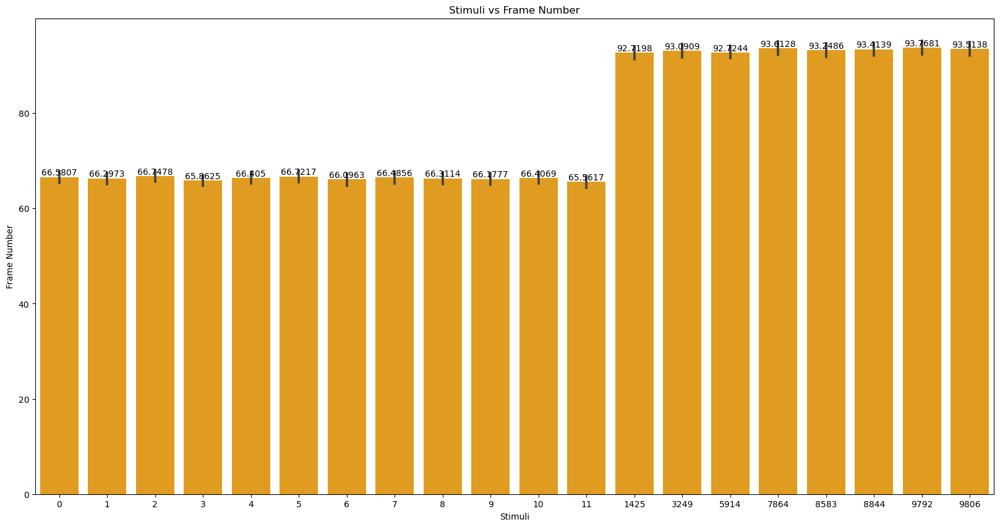

In [18]:
plt.figure(figsize=(20,10))
y= sns.barplot(data=combined, x = 'Stimuli', y='Frame Number',color = 'orange')
y.bar_label(y.containers[0])
plt.title('Stimuli vs Frame Number')
plt.show()

In [19]:
plt.figure(figsize=(50,50))
c= combined.corr().round(2)
# sns.heatmap(c,cmap="BrBG",annot=True)
c

,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,Left_Eye_X,Left_Eye_Y,...,X_Predictions,Y_Predictions,Anger_Probability,Contempt_Probability,Disgust_Probability,Fear_Probability,Happiness_Probability,Neutral_Probability,Sadness_Probability,Surprise_Probability
Stimuli,1.00,0.22,-0.02,0.18,0.01,0.01,0.17,-0.01,0.17,-0.02,...,0.07,0.14,0.53,0.42,0.52,0.38,0.37,0.25,0.60,0.23
Frame Number,0.22,1.00,0.08,0.00,-0.09,-0.09,-0.02,0.07,-0.02,0.07,...,0.02,0.04,0.17,0.11,0.16,0.15,0.13,0.08,0.15,0.05
Face_Y,-0.02,0.08,1.00,-0.22,-0.57,-0.57,-0.33,0.92,-0.32,0.98,...,-0.14,0.01,-0.02,0.01,0.01,0.03,-0.05,0.12,0.03,-0.10
Face_X,0.18,0.00,-0.22,1.00,-0.06,-0.06,0.98,-0.29,0.98,-0.23,...,0.12,0.10,0.24,0.06,0.23,-0.12,-0.08,-0.04,0.11,0.00
Face_W,0.01,-0.09,-0.57,-0.06,1.00,1.00,0.14,-0.22,0.14,-0.44,...,0.08,0.00,-0.05,0.02,-0.05,0.04,0.07,0.01,0.02,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Fear_Probability,0.38,0.15,0.03,-0.12,0.04,0.04,-0.12,0.05,-0.11,0.06,...,-0.00,0.00,-0.18,0.35,-0.17,1.00,0.72,0.19,0.27,0.41
Happiness_Probability,0.37,0.13,-0.05,-0.08,0.07,0.07,-0.07,-0.03,-0.06,-0.03,...,0.04,-0.01,-0.10,0.34,-0.07,0.72,1.00,0.08,0.23,0.33
Neutral_Probability,0.25,0.08,0.12,-0.04,0.01,0.01,-0.03,0.14,-0.03,0.13,...,-0.04,0.04,-0.03,0.41,-0.04,0.19,0.08,1.00,0.42,0.03
Sadness_Probability,0.60,0.15,0.03,0.11,0.02,0.02,0.12,0.02,0.12,0.04,...,0.00,0.02,0.15,0.53,0.11,0.27,0.23,0.42,1.00,0.01


<Figure size 5000x5000 with 0 Axes>

In [20]:
stim = combined['Stimuli'].value_counts().sort_values(ascending=True, key=lambda x: x.index)
stim

0       4276
1       4659
2       4607
3       4598
4       4664
5       4588
6       4623
7       4631
8       4656
9       4638
10      4618
11      4533
1425    6373
3249    6306
5914    6480
7864    6602
8583    6558
8844    6557
9792    6545
9806    6435
Name: Stimuli, dtype: int64

In [21]:
frame =combined['Frame Number'].value_counts().sort_values(ascending=True, key=lambda x: x.index)
frame

0      742
1      745
2      750
3      751
4      749
      ... 
207     68
208     54
209     38
210     13
211      4
Name: Frame Number, Length: 212, dtype: int64

In [22]:
column_name = 'Frame Number'

min_value = combined[column_name].min()
max_value = combined[column_name].max()

print("Minimum value in column '{}': {}".format(column_name, min_value))
print("Maximum value in column '{}': {}".format(column_name, max_value))

Minimum value in column 'Frame Number': 0
Maximum value in column 'Frame Number': 211


### Code for NaN values for all file:

In [23]:
csv_path = r'C:\Users\User\Desktop\rabotno ML\ML- Final Project\Brainster data\1f - Data set'

csv_files = glob.glob(f'{csv_path}/*.csv')

dfs = []
for file in tqdm(csv_files, total = len(csv_files)):
    df = pd.read_csv(file)
    for g, c_df in df.groupby('Stimuli'):
        а=c_df.complete('Study_Folder','Subject_Folder','Stimuli',{"Frame Number": range(0, c_df['Frame Number'].max())},sort=True)

        df = pd.concat([а])
        dfs.append(а)

combined = pd.concat(dfs).reset_index(drop=True)

100%|██████████| 38/38 [00:09<00:00,  3.93it/s]


In [24]:
combined

,Study_Folder,Subject_Folder,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,...,X_Predictions,Y_Predictions,Anger_Probability,Contempt_Probability,Disgust_Probability,Fear_Probability,Happiness_Probability,Neutral_Probability,Sadness_Probability,Surprise_Probability
0,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,0,235.0,195.0,204.0,204.0,269.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,1,235.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,2,236.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,3,236.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,4,235.0,195.0,203.0,203.0,269.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107845,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,200,200.0,162.0,233.0,233.0,243.0,353.0,...,0.124735,0.721234,0.03,0.10,0.00,0.45,0.02,0.01,0.30,0.09
107846,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,201,201.0,160.0,233.0,233.0,243.0,353.0,...,0.223992,0.539739,0.14,0.08,0.08,0.08,0.08,0.11,0.43,0.00
107847,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,202,200.0,162.0,232.0,232.0,244.0,352.0,...,0.124735,0.733096,0.06,0.12,0.06,0.20,0.05,0.02,0.45,0.04
107848,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,203,200.0,159.0,236.0,236.0,243.0,353.0,...,0.124204,0.717675,0.05,0.06,0.01,0.36,0.03,0.03,0.28,0.18


### Show NaN values:

In [25]:
combined.iloc[3380:3400]

,Study_Folder,Subject_Folder,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,...,X_Predictions,Y_Predictions,Anger_Probability,Contempt_Probability,Disgust_Probability,Fear_Probability,Happiness_Probability,Neutral_Probability,Sadness_Probability,Surprise_Probability
3380,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,196,241.0,220.0,194.0,194.0,288.0,378.0,...,0.773060,0.832025,0.70,0.00,0.23,0.0,0.01,0.0,0.06,0.0
3381,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,197,241.0,220.0,194.0,194.0,289.0,378.0,...,0.773060,0.832025,0.73,0.00,0.21,0.0,0.01,0.0,0.05,0.0
3382,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,198,241.0,219.0,193.0,193.0,288.0,378.0,...,0.773060,0.832025,0.76,0.02,0.12,0.0,0.00,0.0,0.10,0.0
3383,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,199,241.0,219.0,194.0,194.0,290.0,375.0,...,0.774524,0.832025,0.84,0.01,0.08,0.0,0.00,0.0,0.07,0.0
3384,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,200,241.0,219.0,194.0,194.0,290.0,375.0,...,0.774524,0.832025,0.88,0.01,0.07,0.0,0.00,0.0,0.04,0.0
3385,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,201,243.0,221.0,190.0,190.0,290.0,378.0,...,0.773060,0.832025,0.72,0.01,0.18,0.0,0.00,0.0,0.09,0.0
3386,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,202,242.0,221.0,192.0,192.0,291.0,375.0,...,0.774524,0.830455,0.72,0.00,0.24,0.0,0.01,0.0,0.03,0.0
3387,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,9806,203,242.0,219.0,193.0,193.0,291.0,375.0,...,0.774524,0.832025,0.84,0.01,0.11,0.0,0.00,0.0,0.04,0.0
3388,9c47bed0-59a8-4fc8-86fb-d5980260e324,videos,0,0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3389,9c47bed0-59a8-4fc8-86fb-d5980260e324,videos,0,1,440.0,77.0,178.0,178.0,148.0,544.0,...,0.124000,0.166667,0.00,0.00,0.00,0.0,0.00,0.0,0.00,0.0


In [26]:
combined.isnull().sum()

Study_Folder                0
Subject_Folder              0
Stimuli                     0
Frame Number                0
Face_Y                   1220
                         ... 
Fear_Probability         1220
Happiness_Probability    1220
Neutral_Probability      1220
Sadness_Probability      1220
Surprise_Probability     1220
Length: 169, dtype: int64

### Save csv file data with NaN:

In [29]:
combined.to_csv('data_with NaN_1.csv', index=False)

In [ ]:
from google.colab import files

files.download('data_with NaN_1.csv')

### Read dataset with NaN:

In [30]:
data= pd.read_csv('data_with NaN_1.csv')
data

,Study_Folder,Subject_Folder,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,...,X_Predictions,Y_Predictions,Anger_Probability,Contempt_Probability,Disgust_Probability,Fear_Probability,Happiness_Probability,Neutral_Probability,Sadness_Probability,Surprise_Probability
0,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,0,235.0,195.0,204.0,204.0,269.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,1,235.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,2,236.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,3,236.0,196.0,201.0,201.0,268.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,4,235.0,195.0,203.0,203.0,269.0,377.0,...,0.124451,0.166405,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107845,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,200,200.0,162.0,233.0,233.0,243.0,353.0,...,0.124735,0.721234,0.03,0.10,0.00,0.45,0.02,0.01,0.30,0.09
107846,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,201,201.0,160.0,233.0,233.0,243.0,353.0,...,0.223992,0.539739,0.14,0.08,0.08,0.08,0.08,0.11,0.43,0.00
107847,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,202,200.0,162.0,232.0,232.0,244.0,352.0,...,0.124735,0.733096,0.06,0.12,0.06,0.20,0.05,0.02,0.45,0.04
107848,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,203,200.0,159.0,236.0,236.0,243.0,353.0,...,0.124204,0.717675,0.05,0.06,0.01,0.36,0.03,0.03,0.28,0.18


In [ ]:
# from google.colab import files
# uploaded = files.upload()

In [ ]:
# import pandas as pd
# import io

# df = pd.read_csv(io.BytesIO(uploaded['data_with NaN_1.csv']))
# df

### Drop columns:

In [31]:
columns_save = ['Study_Folder', 'Subject_Folder', 'Stimuli', 'Frame Number', 'Face_Y', 'Face_X', 'Face_W', 'Face_H', 'Right_Eye_X', 'Right_Eye_Y', 'Left_Eye_X', 'Left_Eye_Y', 'Face_Angle', 'X_Predictions', 'Y_Predictions']
data.drop(columns=[col for col in data.columns if col not in columns_save], inplace=True)

In [32]:
data

,Study_Folder,Subject_Folder,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,Left_Eye_X,Left_Eye_Y,Face_Angle,X_Predictions,Y_Predictions
0,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,0,235.0,195.0,204.0,204.0,269.0,377.0,269.0,296.0,0.469347,0.124451,0.166405
1,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,1,235.0,196.0,201.0,201.0,268.0,377.0,268.0,296.0,0.469335,0.124451,0.166405
2,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,2,236.0,196.0,201.0,201.0,268.0,377.0,268.0,296.0,0.465500,0.124451,0.166405
3,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,3,236.0,196.0,201.0,201.0,268.0,377.0,268.0,296.0,0.477129,0.124451,0.166405
4,0eb02000-fe04-480d-9da4-b60e758d46e7,videos,0,4,235.0,195.0,203.0,203.0,269.0,377.0,268.0,296.0,0.469347,0.124451,0.166405
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107845,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,200,200.0,162.0,233.0,233.0,243.0,353.0,256.0,270.0,0.362527,0.124735,0.721234
107846,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,201,201.0,160.0,233.0,233.0,243.0,353.0,255.0,270.0,0.386992,0.223992,0.539739
107847,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,202,200.0,162.0,232.0,232.0,244.0,352.0,256.0,270.0,0.386993,0.124735,0.733096
107848,7f1cb219-f275-4148-9658-67b1c26a6649,videos,9806,203,200.0,159.0,236.0,236.0,243.0,353.0,255.0,270.0,0.349297,0.124204,0.717675


In [33]:
data.describe()

,Stimuli,Frame Number,Face_Y,Face_X,Face_W,Face_H,Right_Eye_X,Right_Eye_Y,Left_Eye_X,Left_Eye_Y,Face_Angle,X_Predictions,Y_Predictions
count,107850.000000,107850.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000,106630.000000
mean,3371.787390,79.221715,215.796183,173.757320,226.803517,226.803517,262.206537,370.108450,263.798950,287.234277,0.832238,0.521537,0.543010
std,4026.147915,52.466776,63.156677,71.305733,34.740518,34.740518,71.467338,53.764537,72.063643,58.977721,1.352217,0.265114,0.272015
min,0.000000,0.000000,17.000000,16.000000,164.000000,164.000000,90.000000,140.000000,88.000000,76.000000,0.110657,0.122667,0.162500
25%,5.000000,35.000000,189.000000,126.000000,202.000000,202.000000,213.000000,351.000000,213.000000,261.000000,0.292410,0.350260,0.196906
50%,11.000000,72.000000,223.000000,164.000000,220.000000,220.000000,251.000000,372.000000,255.000000,288.000000,0.480721,0.571332,0.500000
75%,7864.000000,118.000000,253.000000,217.000000,245.000000,245.000000,296.000000,399.000000,301.000000,321.000000,0.905816,0.768053,0.832200
max,9806.000000,211.000000,447.000000,393.000000,398.000000,398.000000,477.000000,584.000000,481.000000,506.000000,73.247675,0.875000,0.833333


### Data1_withoutNaN - Filled:

In [34]:
dfs=[]
for g, c_df in data.groupby('Stimuli'):
    if c_df.isna().sum().sum() > 0:
        for c in c_df.columns[4:]:
            #print(g,c)
            na_indexes = c_df[c].isna()
            #print(c_df[na_indexes][c])

            c_df[c] = c_df[c].interpolate()

    dfs.append(c_df)

data1_withoutNan = pd.concat(dfs).reset_index(drop=True)

In [35]:
data1_withoutNan.isna().sum()

Study_Folder      0
Subject_Folder    0
Stimuli           0
Frame Number      0
Face_Y            0
Face_X            0
Face_W            0
Face_H            0
Right_Eye_X       0
Right_Eye_Y       0
Left_Eye_X        0
Left_Eye_Y        0
Face_Angle        0
X_Predictions     0
Y_Predictions     0
dtype: int64

### Save csv file data without NaN:

In [36]:
data1_withoutNan.to_csv('data1_filled.csv', index=False)

In [ ]:
# from google.colab import files

# files.download('data1_filled.csv')